<a href="https://colab.research.google.com/github/2025-DSWU-CS-FP/25_HF021/blob/main/MODEL/yolov8_train.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install ultralytics==8.0.196

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 631.1/631.1 kB 15.5 MB/s eta 0:00:00


In [ ]:
!pip install -U ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 35.4 MB/s eta 0:00:00
  Attempting uninstall: ultralytics
    Found existing installation: ultralytics 8.0.196
    Uninstalling ultralytics-8.0.196:
      Successfully uninstalled ultralytics-8.0.196


In [ ]:
import ultralytics
ultralytics.checks()

Ultralytics 8.3.204 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 39.4/112.6 GB disk)


In [ ]:
from ultralytics import YOLO
print("ultralytics:", YOLO.__module__)
print("버전 확인 OK. 간단 로드 테스트 시작...")
m = YOLO("yolov8s.pt")  # 여기서 에러가 안 나면 해결
print("로드 성공")

ultralytics: ultralytics.models.yolo.model
버전 확인 OK. 간단 로드 테스트 시작...
로드 성공


In [ ]:
!pip install roboflow

from roboflow import Roboflow
from pathlib import Path

rf = Roboflow(api_key="K8SmDUZmmxUnvsucBmQ0")
project = rf.workspace("painting-fvj5e").project("painting-border-detection-180wq")
version = project.version(2)
dataset = version.download("yolov8")
print(Path(dataset.location) / "data.yaml")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Painting-Border-detection-2 in yolov8:: 100%|██████████| 4754/4754 [00:00<00:00, 7048.01it/s]


/content/Painting-Border-detection-2/data.yaml


In [ ]:
# 모델 학습

!yolo task=detect mode=train model=yolov8s.pt data=/content/Painting-Border-detection-2/data.yaml epochs=500

Ultralytics 8.3.204 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Painting-Border-detection-2/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=500, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0

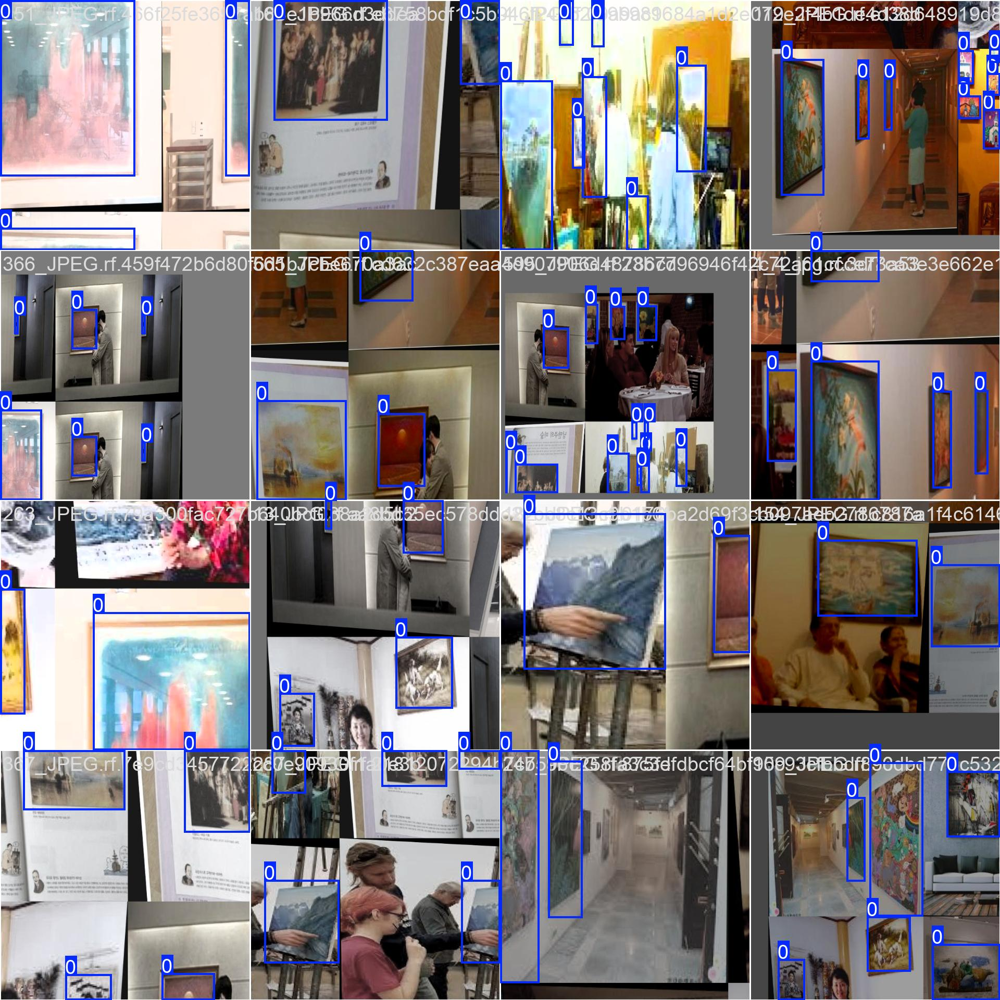

In [ ]:
from IPython.display import Image

# 결과 그래프 확인 (loss, mAP, precision, recall 등)
Image(filename='runs/detect/train/train_batch1.jpg', width=800)

In [ ]:
# 모델 검증

!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.7 source=/content/Painting-Border-detection-2/test/images save=True

Ultralytics 8.3.203 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs

image 1/142 /content/Painting-Border-detection-2/test/images/107_JPEG.rf.0966d5f374f60a73ca17e63a5c01fd46.jpg: 640x640 4 0s, 16.3ms
image 2/142 /content/Painting-Border-detection-2/test/images/113_JPEG.rf.dde1d86a3df9e3b02c1d5ae4fb6f3178.jpg: 640x640 2 0s, 16.2ms
image 3/142 /content/Painting-Border-detection-2/test/images/116_JPEG.rf.b016e3759c0e8208538eebce01ea5ba1.jpg: 640x640 1 0, 16.2ms
image 4/142 /content/Painting-Border-detection-2/test/images/12_JPEG.rf.bff22fa416447c0b3f4858877d856c10.jpg: 640x640 3 0s, 16.2ms
image 5/142 /content/Painting-Border-detection-2/test/images/138_JPEG.rf.9840504a2f7a3262a70d9243507ffe42.jpg: 640x640 1 0, 16.2ms
image 6/142 /content/Painting-Border-detection-2/test/images/15_JPG.rf.e2a149f0593546274b6cd03f7f7c5940.jpg: 640x640 1 0, 16.2ms
image 7/142 /content/Painting-Border-detection-2

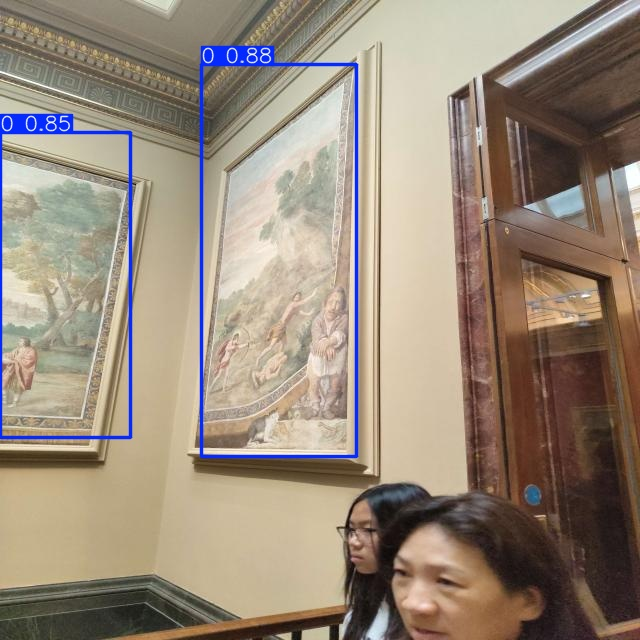

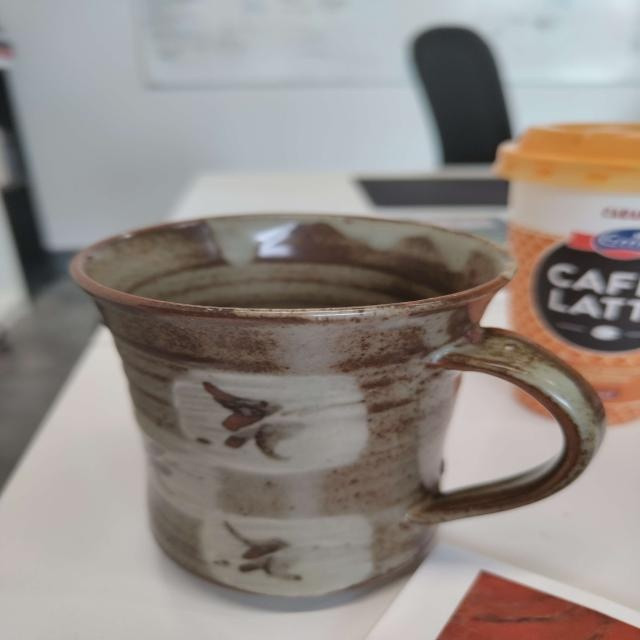

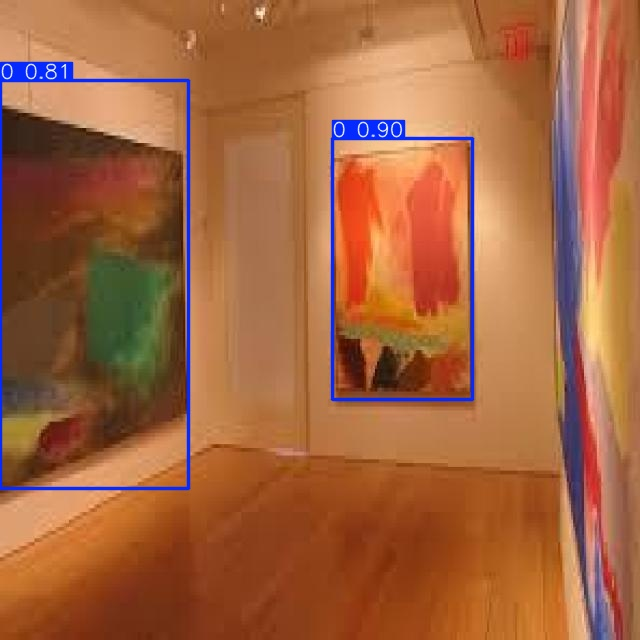

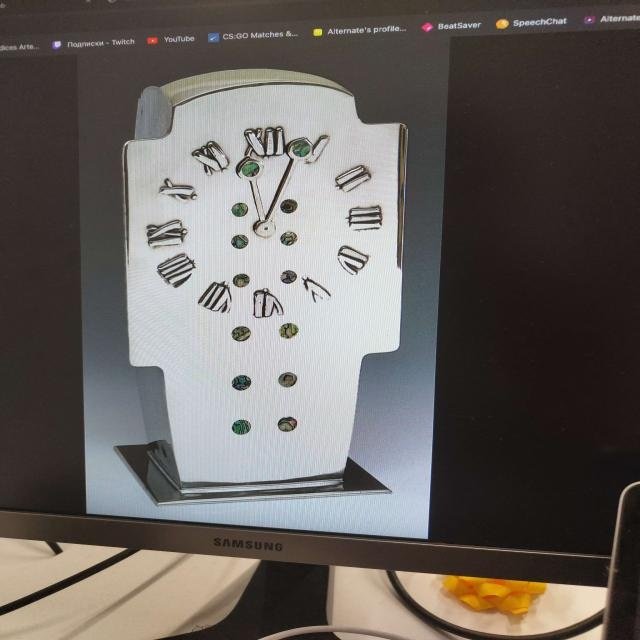

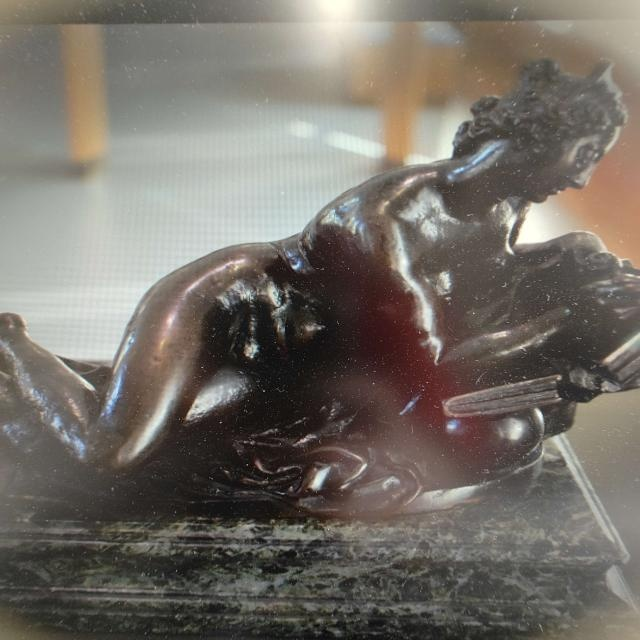

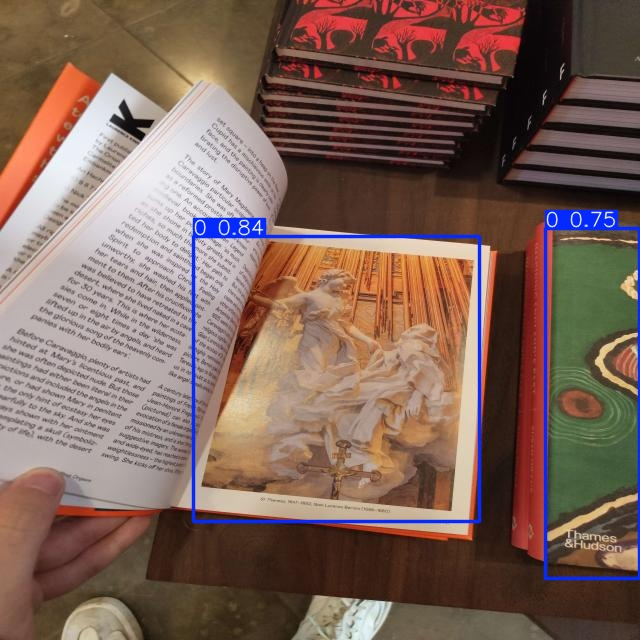

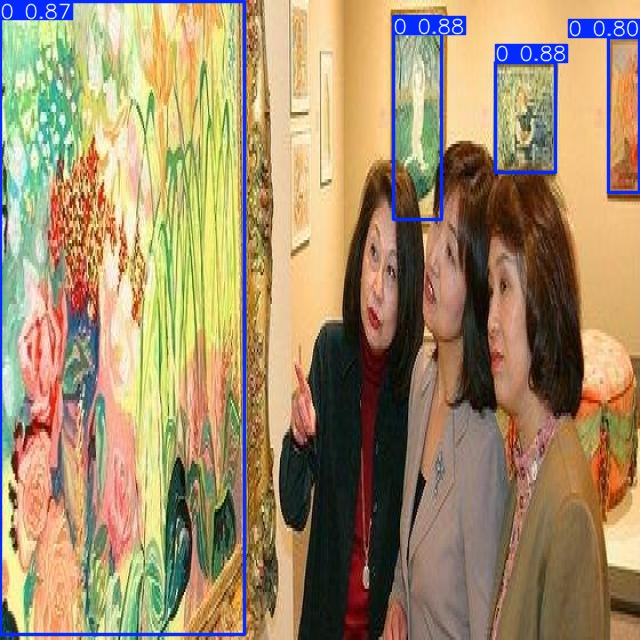

In [ ]:
# 테스트 이미지 출력 2

import glob
from IPython.display import Image, display

for image_path in glob.glob('/content/runs/detect/predict/*.jpg')[:7]:
  display(Image(filename=image_path, width=640))
  print("\n")

In [ ]:
# 모델 검증 2

!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.7 source=/content/Painting-Border-detection-2/test/images_eyedia save=True

Ultralytics 8.3.203 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs

image 1/7 /content/Painting-Border-detection-2/test/images_eyedia/IMG_6876.JPG: 480x640 1 0, 41.6ms
image 2/7 /content/Painting-Border-detection-2/test/images_eyedia/IMG_6877.JPG: 640x480 1 0, 41.7ms
image 3/7 /content/Painting-Border-detection-2/test/images_eyedia/IMG_6878.JPG: 480x640 1 0, 13.8ms
image 4/7 /content/Painting-Border-detection-2/test/images_eyedia/IMG_6879.JPG: 640x480 1 0, 12.8ms
image 5/7 /content/Painting-Border-detection-2/test/images_eyedia/IMG_6880.JPG: 640x480 1 0, 12.1ms
image 6/7 /content/Painting-Border-detection-2/test/images_eyedia/IMG_6881.JPG: 640x480 1 0, 12.1ms
image 7/7 /content/Painting-Border-detection-2/test/images_eyedia/IMG_6882.JPG: 640x480 2 0s, 12.1ms
Speed: 2.9ms preprocess, 20.9ms inference, 19.6ms postprocess per image at shape (1, 3, 640, 480)
Results saved to /content/runs/dete

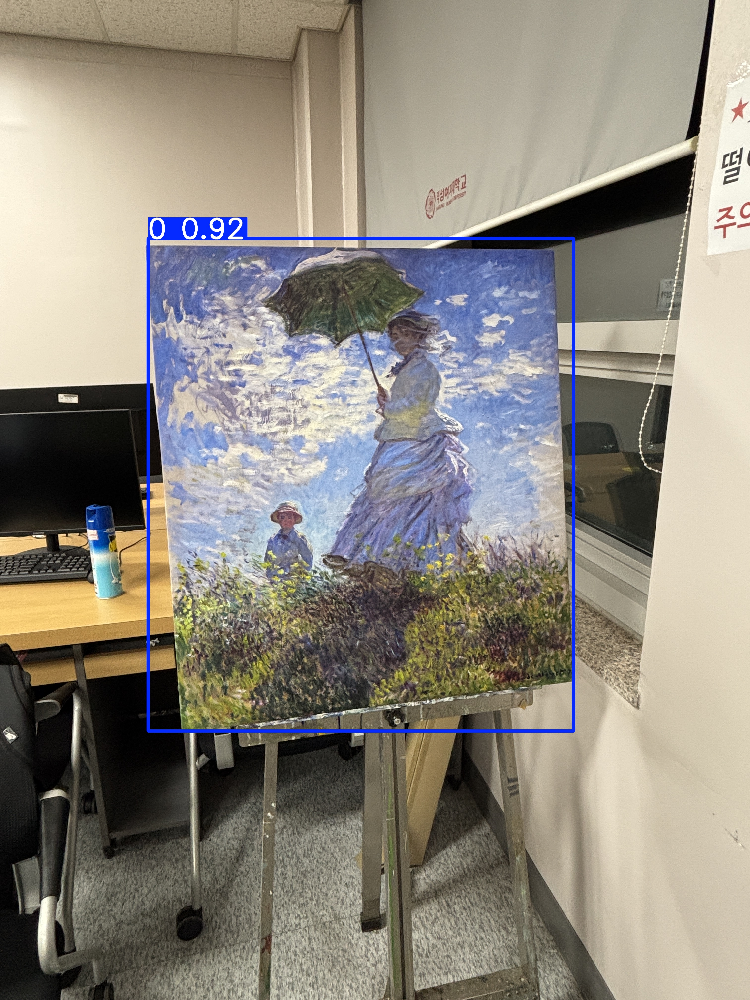

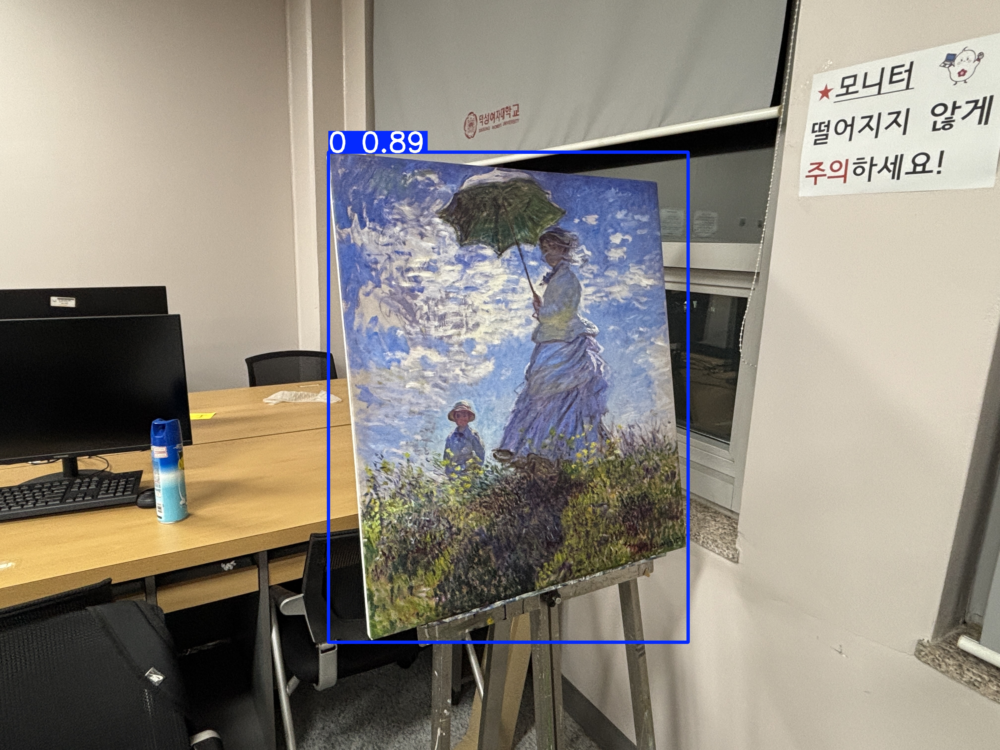

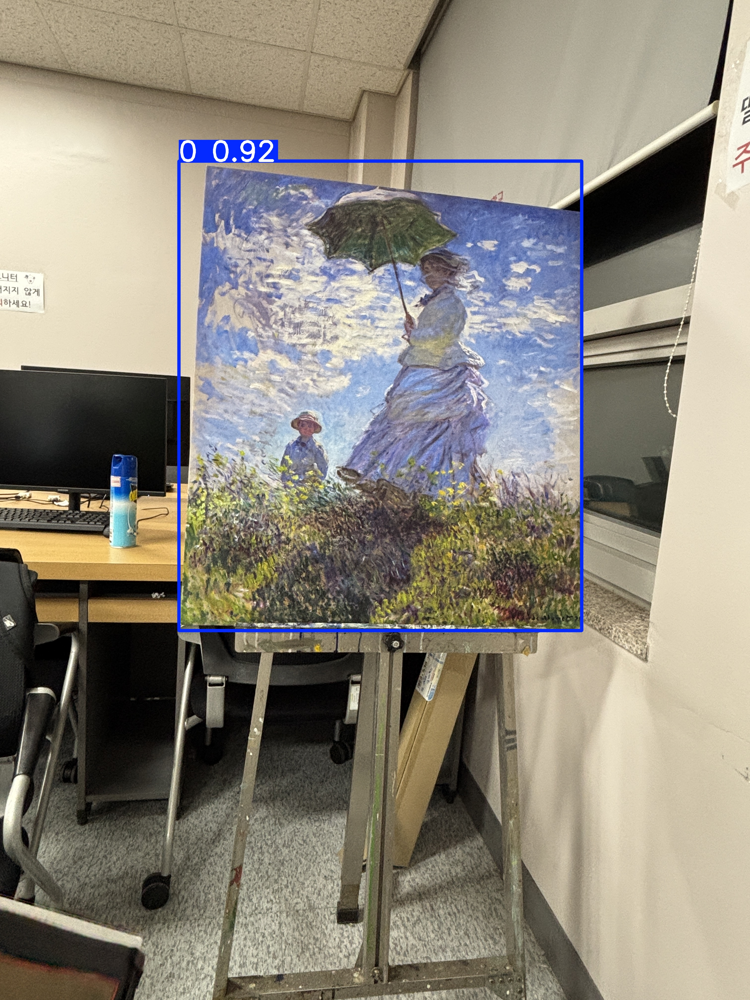

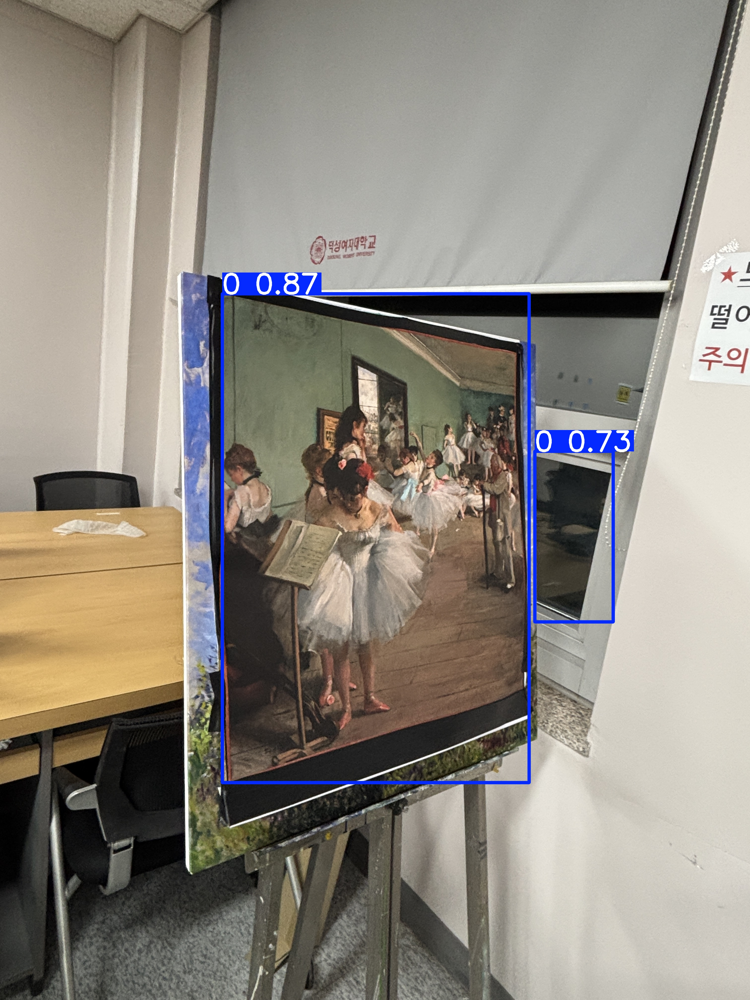

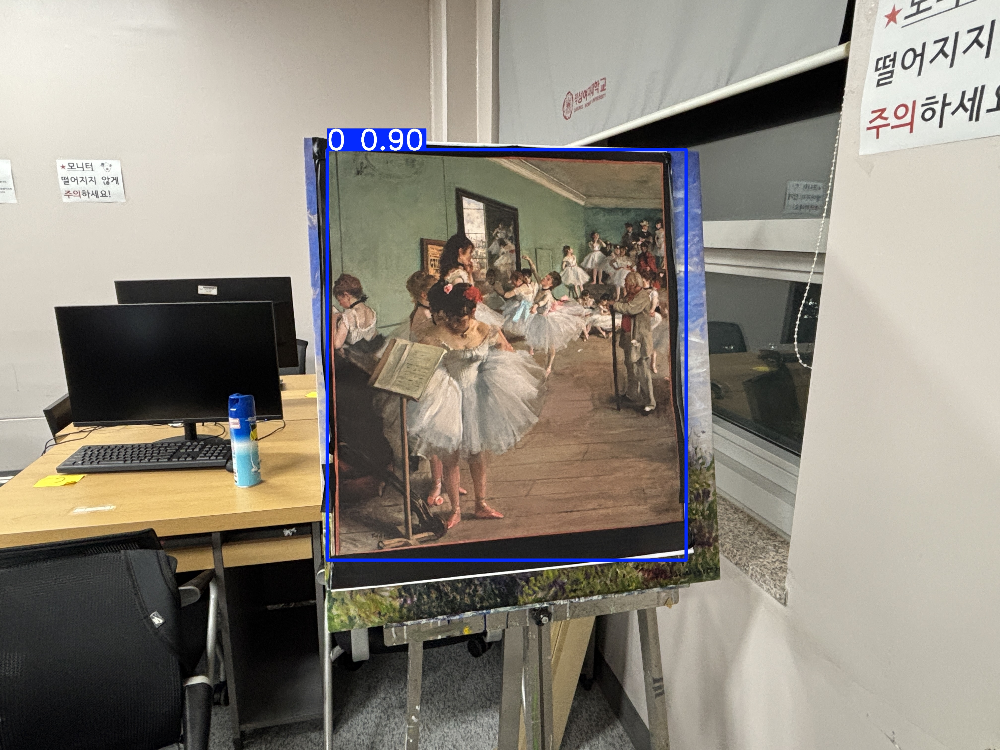

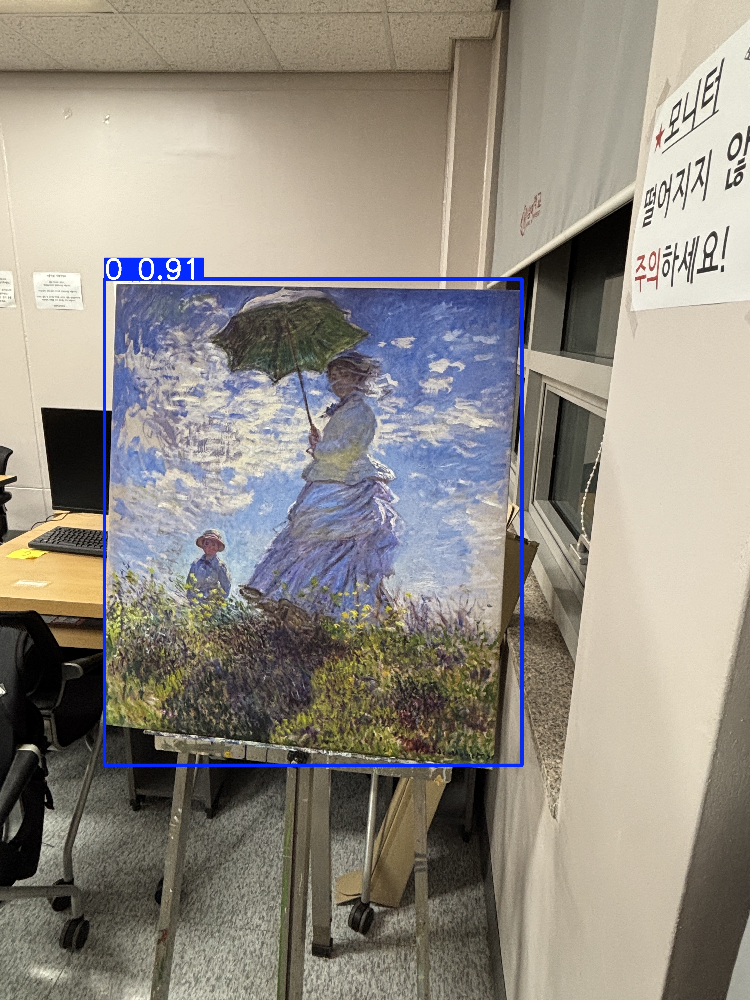

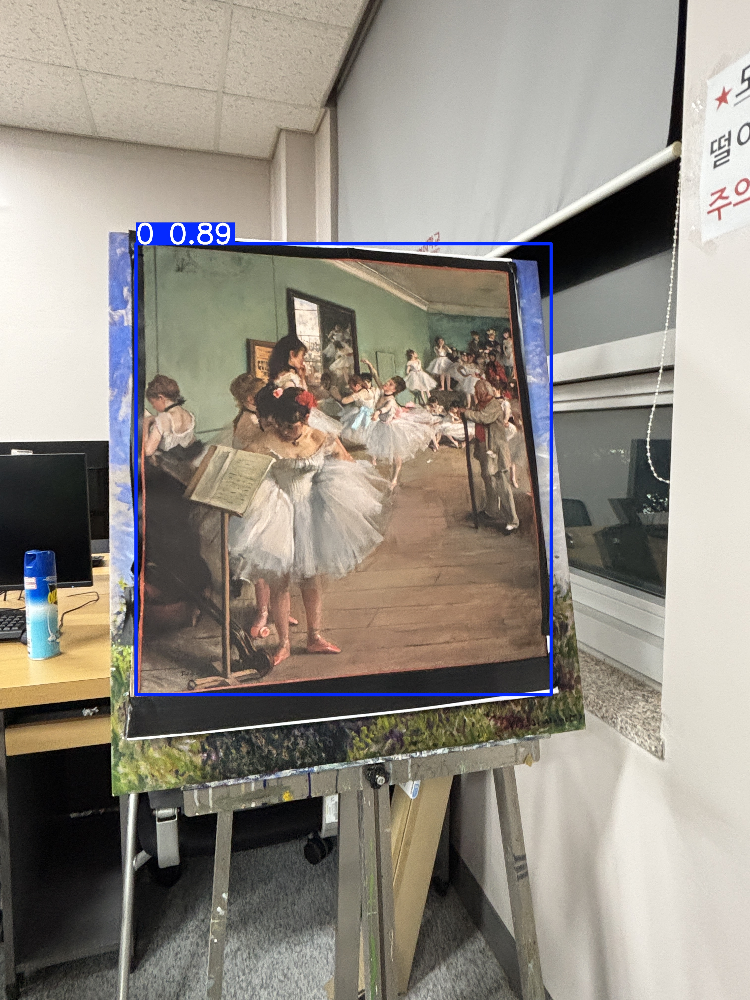

In [ ]:
# 테스트 이미지 출력 2

import glob
from IPython.display import Image, display

for image_path in glob.glob('/content/runs/detect/predict2/*.jpg')[:7]:
  display(Image(filename=image_path, width=640))
  print("\n")

In [ ]:
# mAP 확인하기

from ultralytics import YOLO

# 학습된 모델 불러오기
model = YOLO("/content/runs/detect/train2/weights/best.pt")

# 검증 실행
metrics = model.val()   # 기본: data.yaml에 정의된 val 세트로 평가
print(metrics)

Ultralytics 8.3.204 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1818.6±684.5 MB/s, size: 55.2 KB)
val: Scanning /content/Painting-Border-detection-2/valid/labels.cache... 141 images, 2 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 141/141 163.5Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 9/9 2.8it/s 3.2s
                   all        141        334      0.885      0.827      0.884      0.684
Speed: 2.2ms preprocess, 10.6ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to /content/runs/detect/val2
ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d7b04b228a0>
curves: ['Precision-Recall(B)', 'F1-C